In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.figure_factory as ff

df = pd.read_pickle('data/final_dataset.pk1')

In [2]:
# https://colorbrewer2.org/#type=diverging&scheme=RdGy&n=10

DIVERGENT_RGB = ['rgb(103,0,31)','rgb(178,24,43)',
                 'rgb(214,96,77)','rgb(244,165,130)',
                 'rgb(253,219,199)','rgb(224,224,224)',
                 'rgb(186,186,186)','rgb(135,135,135)',
                 'rgb(77,77,77)','rgb(26,26,26)']

#FOUR OF EACH
DIVERGENT_RGB = ['rgb(127,59,8)','rgb(179,88,6)',
                 'rgb(224,130,20)','rgb(253,184,99)',
                 'rgb(254,224,182)','rgb(216,218,235)',
                 'rgb(178,171,210)','rgb(128,115,172)',
                 'rgb(84,39,136)','rgb(45,0,75)']

DIVERGENT_RGB = ['rgb(127,59,8)','rgb(179,88,6)',
                 'rgb(224,130,20)','rgb(253,184,99)',
                'rgb(216,218,235)',
                 'rgb(178,171,210)','rgb(128,115,172)',
                 'rgb(84,39,136)','rgb(45,0,75)', 'rgb(0,0,0)']

DECILE_RGB = ['rgb(251,253,248)','rgb(247,252,240)','rgb(224,243,219)',
                'rgb(204,235,197)','rgb(168,221,181)',
                'rgb(123,204,196)','rgb(78,179,211)',
                'rgb(43,140,190)','rgb(8,104,172)',
                'rgb(8,64,129)', 'rgb(5,41,82)',
                'rgb(0,0,0)', 'rgb(0,0,0)']

QUARTILE_RGB = ['rgb(168,221,181)','rgb(123,204,196)',
                'rgb(78,179,211)','rgb(43,140,190)',
                'rgb(8,104,172)','rgb(8,64,129)',
                'rgb(5,41,82)','rgb(0,0,0)']

def map_by_county(att, bins, df=df, title=None, colorscale=DECILE_RGB):
    values = df[att].tolist()
    fips = df['FIPS'].tolist()   
    
    if not title:
        title = att + " by County"

    fig = ff.create_choropleth(
        fips=fips, values=values, binning_endpoints=bins, colorscale=colorscale,
        county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
        legend_title=att, title=title
    )
    fig.layout.template = None
    
    return fig

# Unemployment #

In [3]:
# Use deciles from April 2020 as bins for all employment data for consistency (Change to April)
unemp_bins = list(pd.qcut(df['Mar-20'],10, retbins=True)[-1])
map_by_county('Mar-20', unemp_bins, title="March 2020 Unemployment by County")

In [4]:
# Comparison Data
map_by_county('Feb-20', unemp_bins, title="Februrary 2020 Unemployment by County")

In [5]:
# Comparison data
map_by_county('Apr-19', unemp_bins, title="April 2019 Unemployment by County")

<function matplotlib.pyplot.show(*args, **kw)>

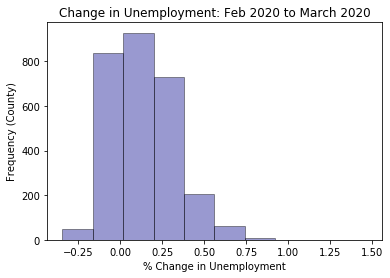

In [6]:
sns.distplot(df['monthly_change'], hist=True, kde=False, 
             bins=10, color = 'darkblue', 
              hist_kws={'edgecolor':'black'},
              kde_kws={'linewidth': 4})
plt.xlabel('% Change in Unemployment')
plt.ylabel('Frequency (County)')
plt.title('Change in Unemployment: Feb 2020 to March 2020')
plt.show

In [7]:
df['monthly_change'].describe()

count    2826.000000
mean        0.137390
std         0.187900
min        -0.346154
25%        -0.015565
50%         0.132704
75%         0.255319
max         1.466667
Name: monthly_change, dtype: float64

In [8]:
unemp_change_bins = [-0.5, -.25, 0, .25, .5, .75, 1., 1.25, 1.5] #update colors add 1.5 add one color

In [9]:
# orange = ['rgb(255,245,235)','rgb(254,230,206)','rgb(253,208,162)','rgb(253,174,107)','rgb(253,141,60)','rgb(241,105,19)','rgb(217,72,1)','rgb(166,54,3)','rgb(127,39,4)']
# blue = ['rgb(247,251,255)','rgb(222,235,247)','rgb(198,219,239)','rgb(158,202,225)','rgb(107,174,214)','rgb(66,146,198)','rgb(33,113,181)','rgb(8,81,156)','rgb(8,48,107)']
orange = ['rgb(254,230,206)','rgb(253,208,162)','rgb(253,174,107)','rgb(253,141,60)','rgb(241,105,19)','rgb(217,72,1)','rgb(166,54,3)','rgb(127,39,4)']
blue = ['rgb(158,202,225)','rgb(107,174,214)','rgb(66,146,198)']

blue.reverse()

blue.extend(orange)

# DIVERGENT_RGB = ['rgb(127,59,8)','rgb(179,88,6)',
#                  'rgb(224,130,20)','rgb(253,184,99)',
#                  'rgb(254,224,182)','rgb(247,247,247)',
#                  'rgb(178,171,210)',
#                  'rgb(128,115,172)','rgb(84,39,136)',
#                  'rgb(45,0,75)']
# DIVERGENT_RGB.reverse()

In [10]:
# Change to February-April? ### FIX TO MAKE SURE ALL POSITIVES ARE PURPLE
map_by_county('monthly_change', unemp_change_bins,
                title="Change in Unemployment: Feb 2020 to March 2020",
                colorscale=blue)

<function matplotlib.pyplot.show(*args, **kw)>

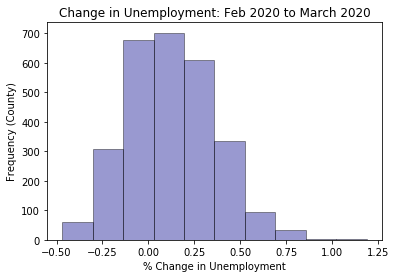

In [11]:
sns.distplot(df['yearly_change'], hist=True, kde=False, 
             bins=10, color = 'darkblue', 
              hist_kws={'edgecolor':'black'},
              kde_kws={'linewidth': 4})
plt.xlabel('% Change in Unemployment')
plt.ylabel('Frequency (County)')
plt.title('Change in Unemployment: Feb 2020 to March 2020')
plt.show

In [12]:
# Change to April
map_by_county('yearly_change', unemp_change_bins,
                title='Change in Unemployment: March 2019 to March 2020',
                colorscale=DIVERGENT_RGB)

<function matplotlib.pyplot.show(*args, **kw)>

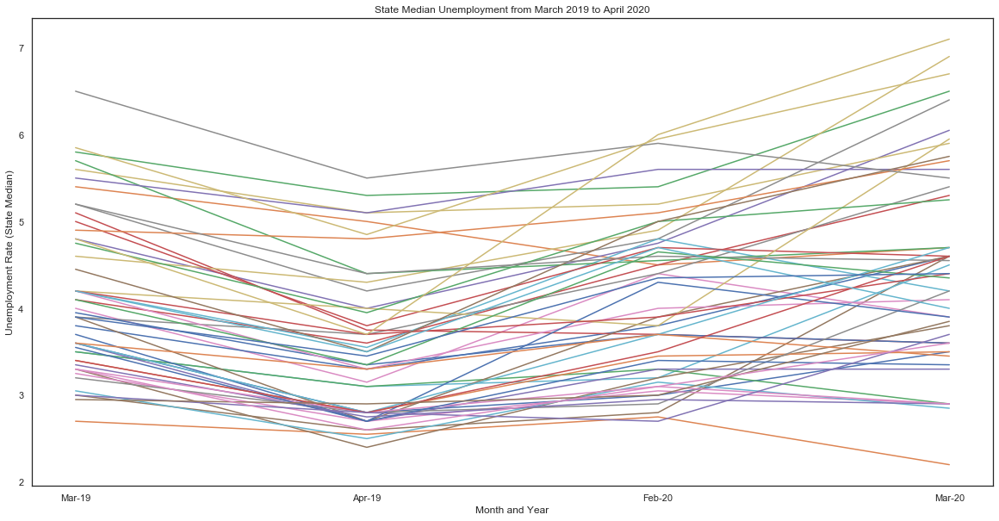

In [13]:
unemp = df[['Mar-19','Apr-19','Feb-20','Mar-20']].groupby(df['state_name']).agg('median').reset_index()
unemp = unemp.transpose()
new_header = unemp.iloc[0] #grab the first row for the header
unemp = unemp[1:] #take the data less the header row
unemp.columns = new_header

sns.set(rc={'figure.figsize':(20, 10)})
sns.set_style('white')
fig, ax = plt.subplots()
for state in unemp.columns:
    ax.plot(unemp.index, unemp[state], label=state)

#leg = ax.legend(frameon=False, loc='best'); #these are the state lables ?? how best to show them
plt.xlabel("Month and Year")
plt.ylabel("Unemployment Rate (State Median)")
plt.title("State Median Unemployment from March 2019 to April 2020")
plt.show

## COVID-19 Data

In [14]:
bins = df['covid_cases'].describe().tolist()[3:]
map_by_county('covid_cases', bins,
                title="Reported COVID Cases by County",
                colorscale=QUARTILE_RGB)

<function matplotlib.pyplot.show(*args, **kw)>

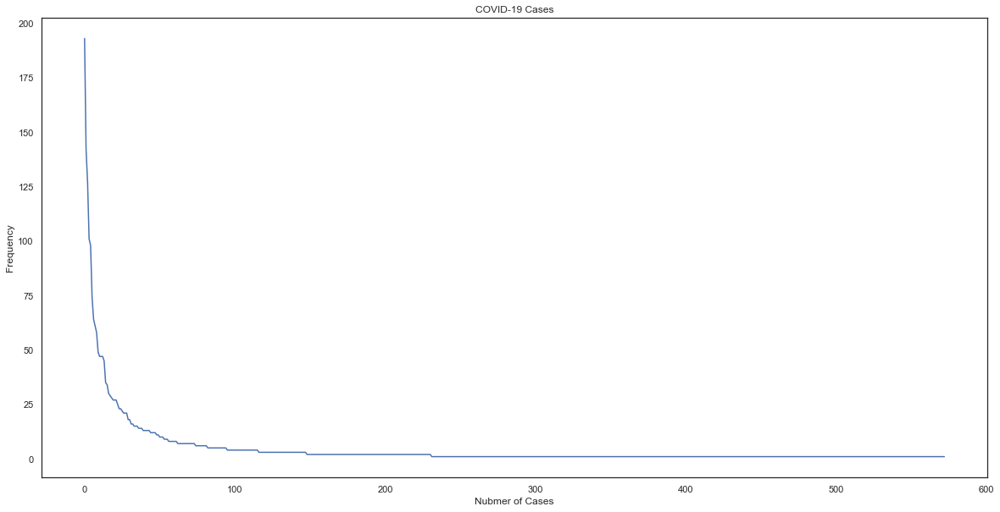

In [15]:
count_cases = df['covid_cases'].value_counts().sort_values(ascending=False).reset_index()
sns.lineplot(x=count_cases.index,y=count_cases['covid_cases'])
plt.title("COVID-19 Cases")
plt.xlabel("Nubmer of Cases")
plt.ylabel("Frequency")
plt.show

In [16]:
bins = df['Testing_Rate'].describe().tolist()[3:]
map_by_county('Testing_Rate', bins,
                title="Testing Rate (Reported at State Level)",
                colorscale=QUARTILE_RGB)

<function matplotlib.pyplot.show(*args, **kw)>

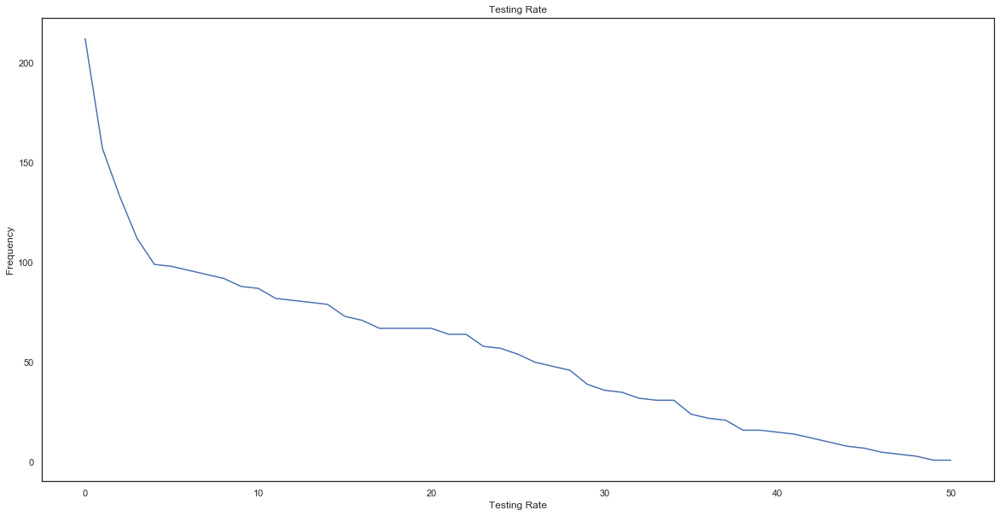

In [17]:
count_cases = df['Testing_Rate'].value_counts().sort_values(ascending=False).reset_index().reset_index()
sns.lineplot(x=count_cases.index,y=count_cases['Testing_Rate'])
plt.title("Testing Rate")
plt.xlabel("Testing Rate")
plt.ylabel("Frequency")
plt.show

In [18]:
bins = df['days_closed'].describe().tolist()[3:]
map_by_county('days_closed', bins,
                title="Number of Days Closed as of April 20",
                colorscale=QUARTILE_RGB)

<function matplotlib.pyplot.show(*args, **kw)>

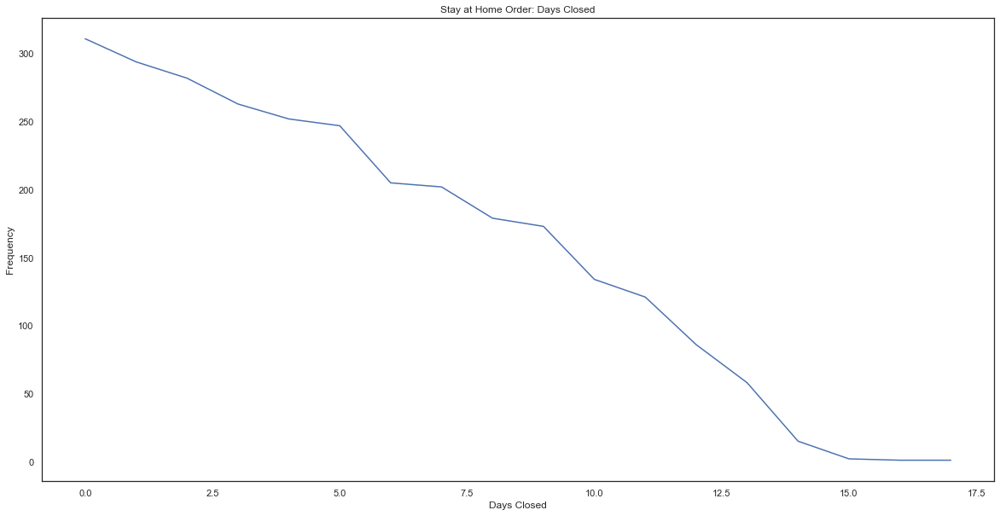

In [19]:
count_cases = df['days_closed'].value_counts().sort_values(ascending=False).reset_index()
sns.lineplot(x=count_cases.index,y=count_cases['days_closed'])
plt.title("Stay at Home Order: Days Closed")
plt.xlabel("Days Closed")
plt.ylabel("Frequency")
plt.show

## Unemployment and COVID-19 Data

<function matplotlib.pyplot.show(*args, **kw)>

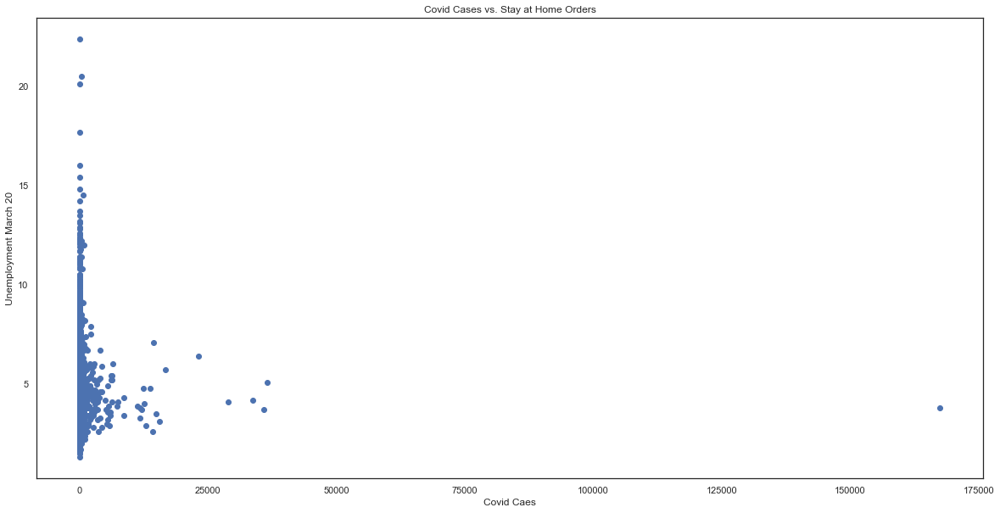

In [20]:
plt.scatter(x=df['covid_cases'], y=df['Mar-20'])
plt.title("Covid Cases vs. Stay at Home Orders")
plt.xlabel("Covid Caes")
plt.ylabel("Unemployment March 20")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

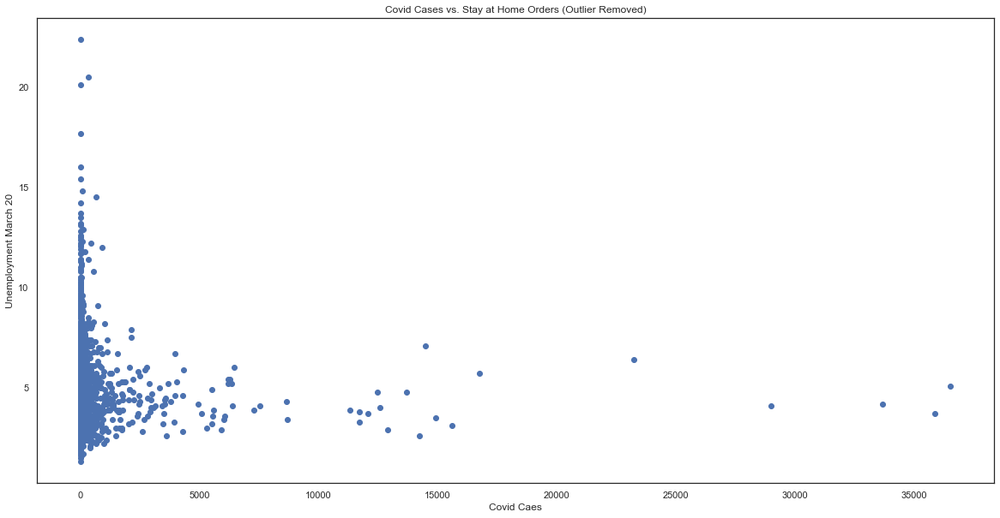

In [21]:
no_outlier = df[df['covid_cases'] != df['covid_cases'].agg('max')]
plt.scatter(x=no_outlier['covid_cases'], y=no_outlier['Mar-20'])
plt.title("Covid Cases vs. Stay at Home Orders (Outlier Removed)")
plt.xlabel("Covid Caes")
plt.ylabel("Unemployment March 20")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

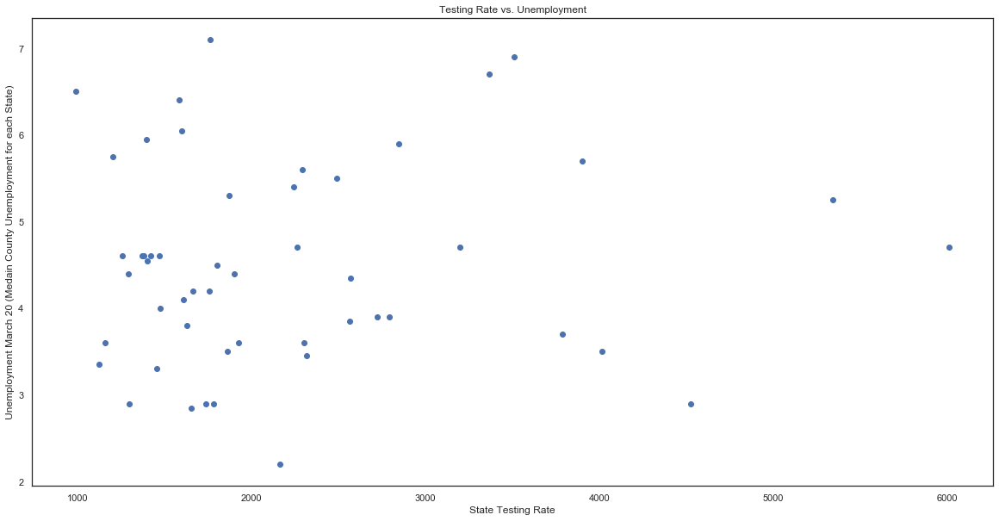

In [22]:
state_unemp = df['Mar-20'].groupby(df['state_name']).agg('median').reset_index()
test_unemp = state_unemp.merge(df[['state_name', 'Testing_Rate']]).drop_duplicates()

plt.scatter(x=test_unemp['Testing_Rate'], y=test_unemp['Mar-20'])
plt.title("Testing Rate vs. Unemployment")
plt.xlabel("State Testing Rate")
plt.ylabel("Unemployment March 20 (Medain County Unemployment for each State)")
plt.show

## Demographic Trends

In [23]:
def trends(att):
    fig, (ax1,ax2) = plt.subplots(1,2)
    title = 'Unemployment variation by ' + att
    fig.suptitle(title)
    ax1.scatter(df[att],df['monthly_change'])
    ax1.set(xlabel=att, ylabel="% Change in Unemployment: February 2020 to March 2020")

    ax2.scatter(df[att], df['yearly_change'])
    ax2.set(xlabel=att, ylabel="% Change in Unemployment: March 2019 to March 2020")
    
    return fig

In [24]:
df.dtypes

name                 object
total_pop             int64
median_income       float64
state                object
county               object
county_name          object
state_name           object
prop_white          float64
prop_black          float64
prop_hisp           float64
log_med_income      float64
prop_no_internet    float64
prop_ba             float64
prop_services       float64
pop_density         float64
FIPS                float64
covid_cases           int64
Testing_Rate        float64
gov_party             int64
election_diff       float64
Apr-19              float64
Mar-19              float64
Feb-20              float64
Mar-20              float64
days_closed         float64
yearly_change       float64
monthly_change      float64
dtype: object

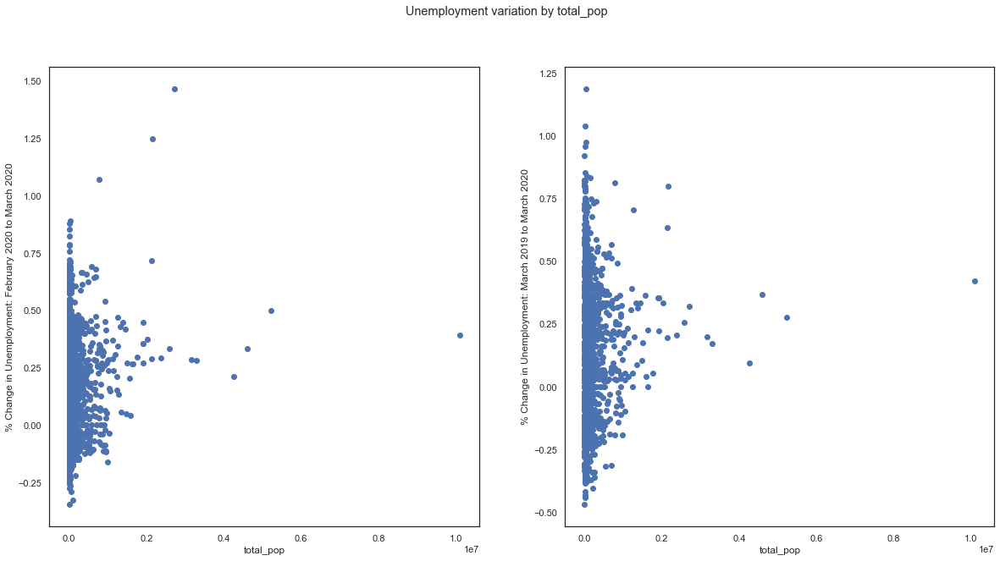

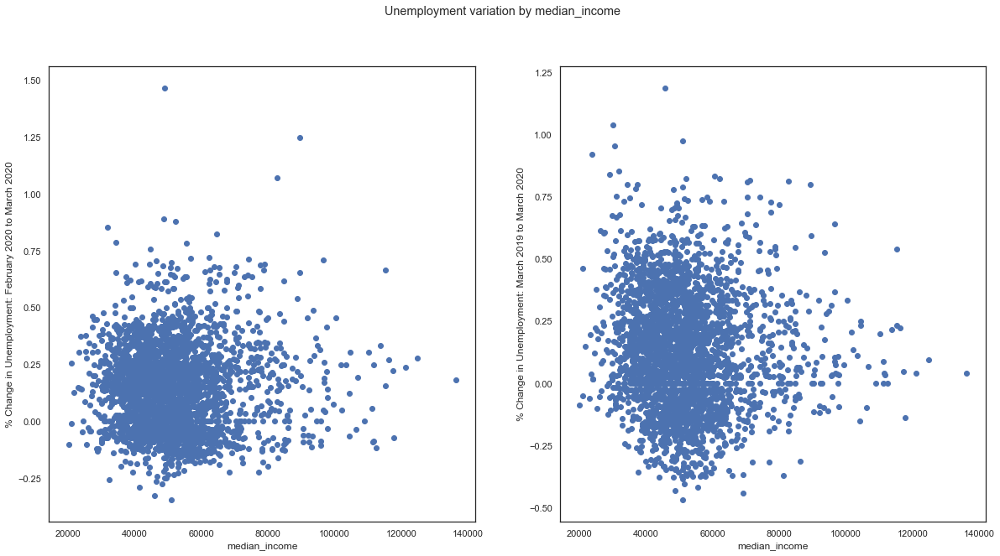

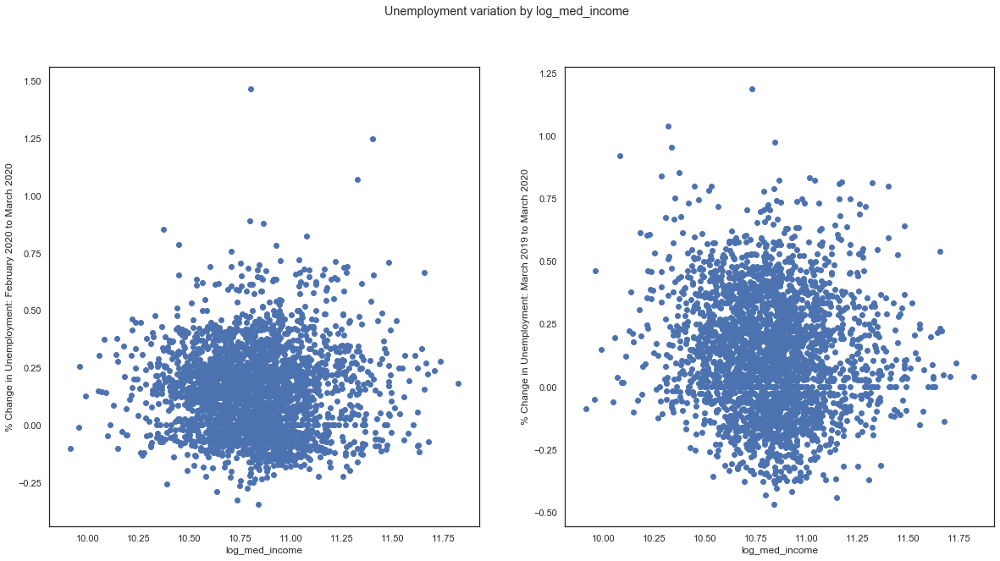

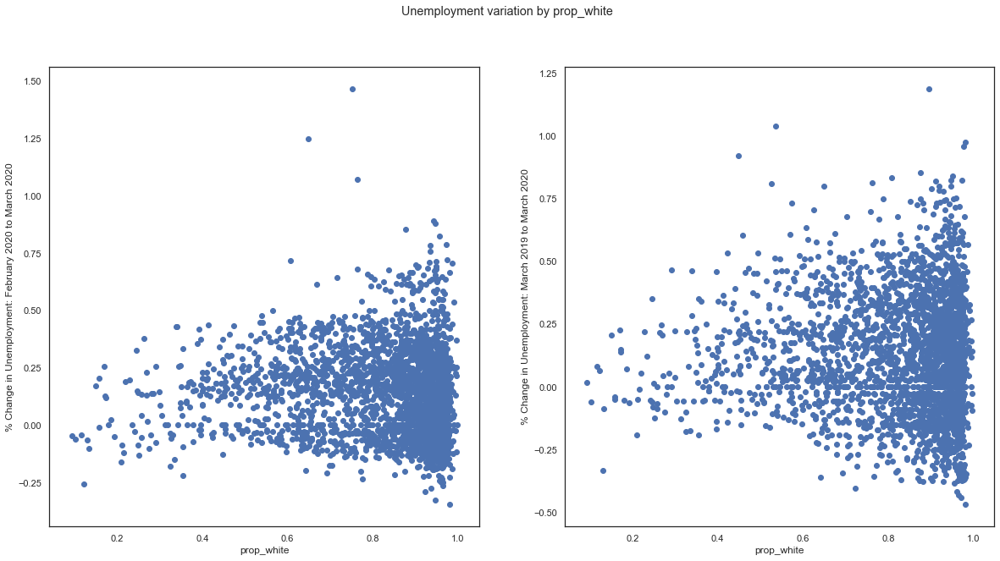

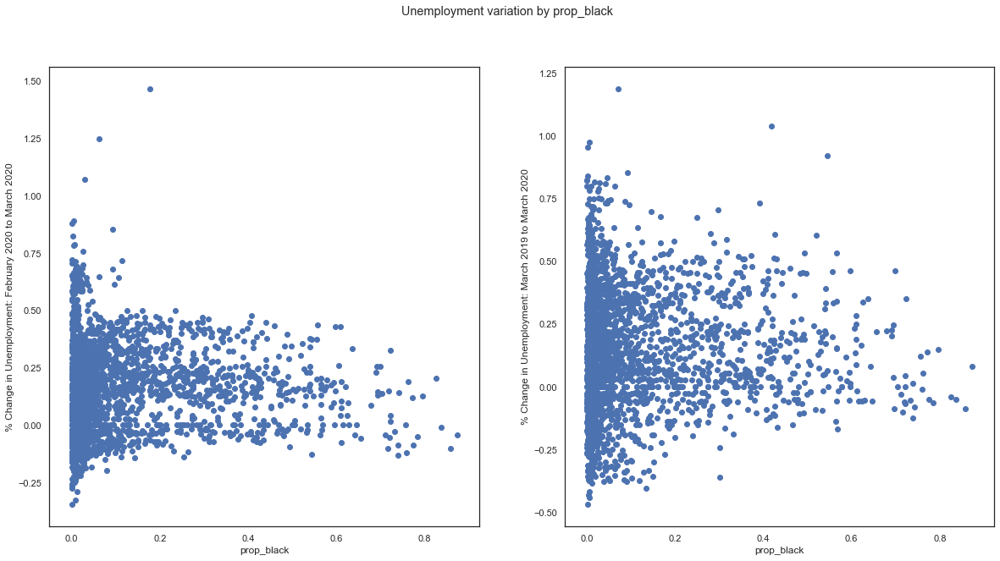

...

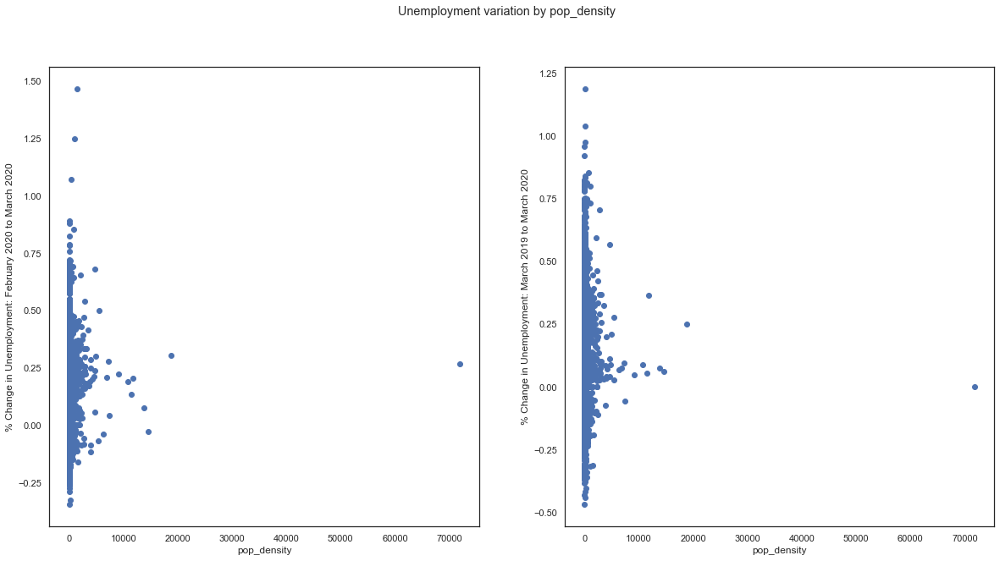

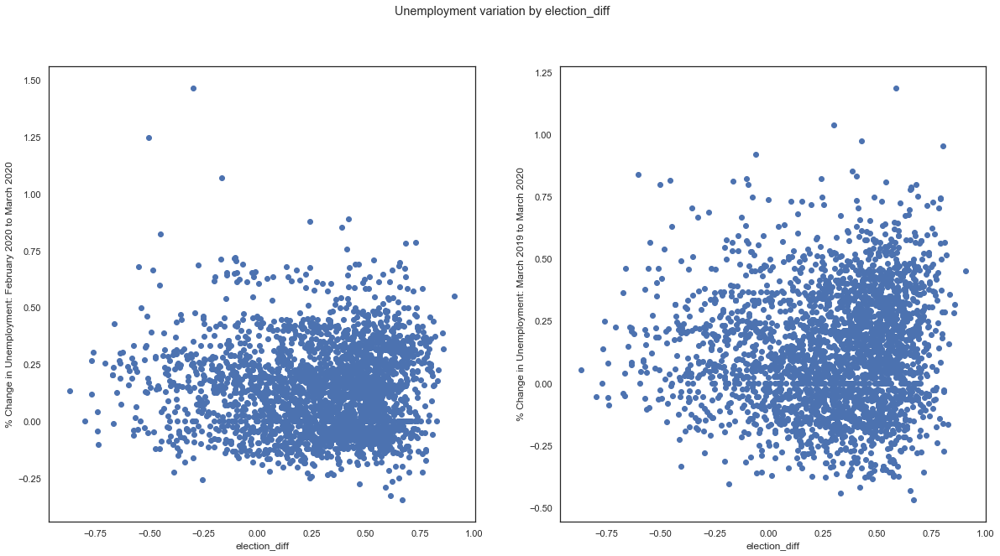

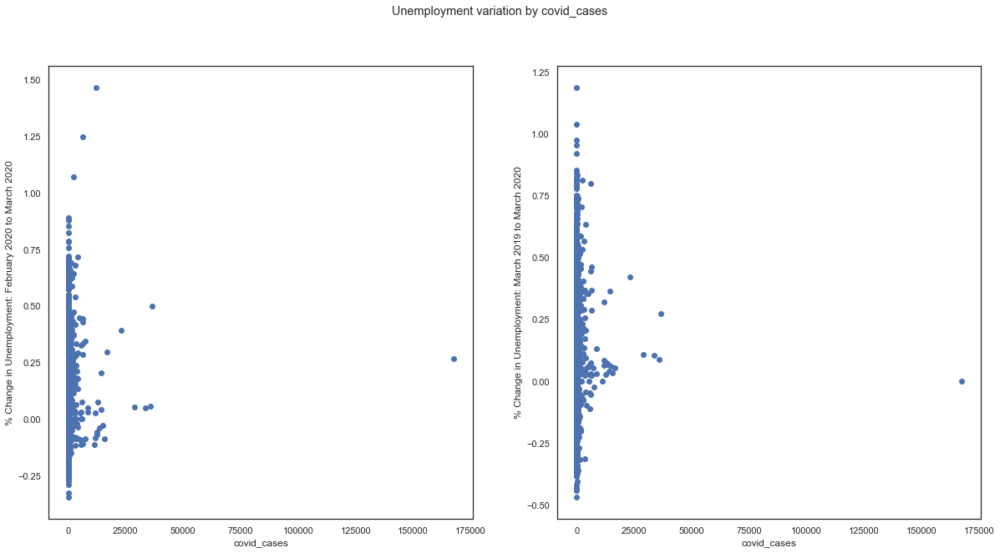

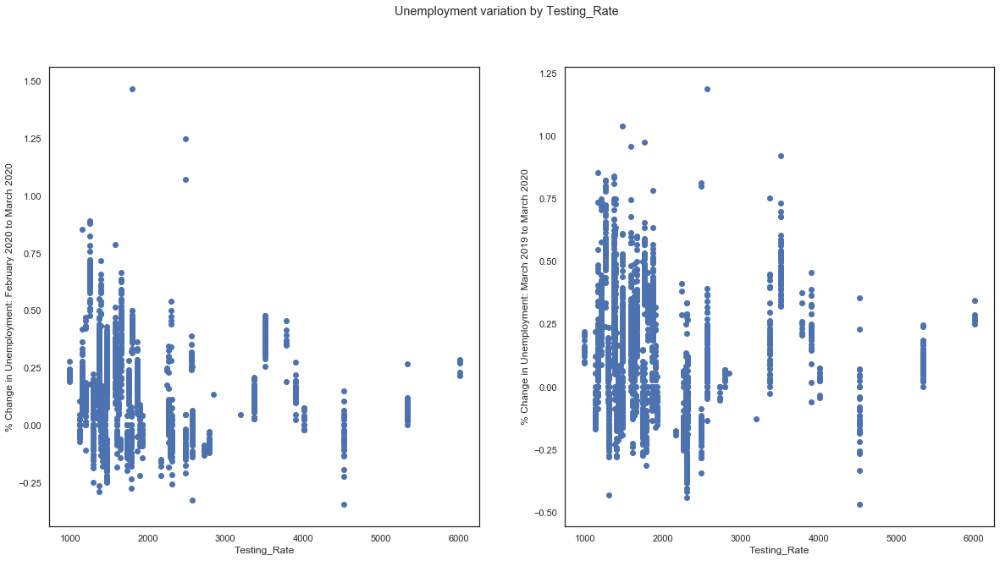

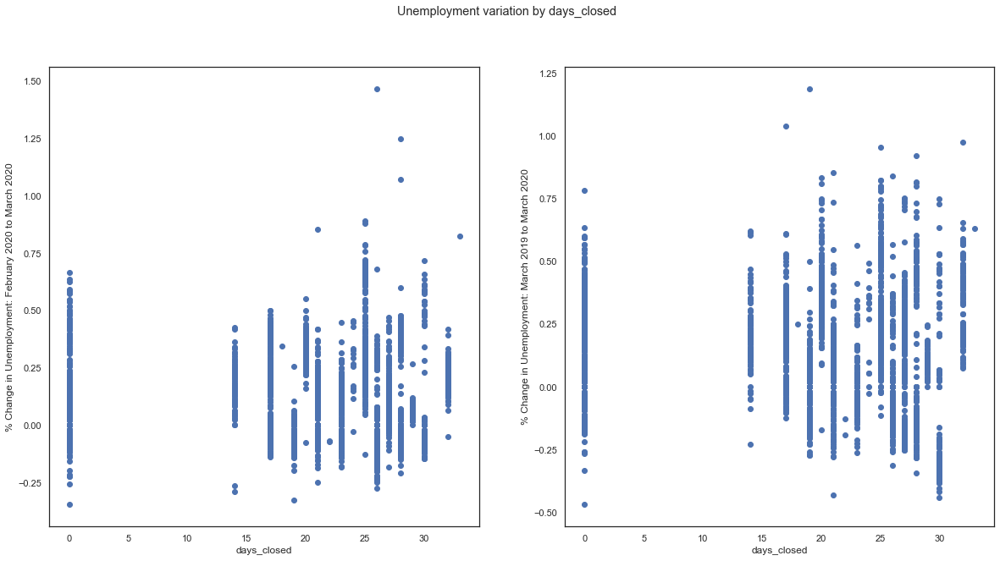

In [26]:
features = ['total_pop','median_income','log_med_income','prop_white', 'prop_black', 'prop_hisp', 'prop_no_internet', 'prop_ba',
        'prop_services', 'pop_density','election_diff','covid_cases','Testing_Rate','days_closed']

for feat in features:
    trends(feat)